# initialization

In [4]:
import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import dateparser
from pandas_profiling import ProfileReport
from fuzzywuzzy import fuzz, process
import Levenshtein as lev
import tldextract
from cleanco import prepare_terms, basename
from urllib.parse import urlparse
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import unidecode
import re
import string

In [5]:
# select ai.*, ls.ios_id as id_matched
# from app_info ai
# join learning_set ls on ai.id = ls.android_id
# where ai.store = '0' 
# union
# select ai.*, ls.android_id as id_matched
# from app_info ai
# join learning_set ls on ai.id = ls.ios_id
# where ai.store = '1'

df = pd.read_csv('apps_matching.csv')

df.shape

/usr/local/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (32) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


(191524, 33)

In [3]:
(df['id'].value_counts() > 1).value_counts()

False    191107
True        208
Name: id, dtype: int64

In [4]:
google_play_df = df[df['store'] == 0]
app_store_df = df[df['store'] == 1]

In [7]:
# Change from apple catagories ids to string catagories

app_store_df.loc[:, 'maincategory'].replace(['6000',
 '6001','6002','6003','6004','6005','6006','6007','6008',
'6009','6010','6011','6012','6013','6014','6015','6016','6017',
 '6018','6020','6021','6023','6024','6025','6026','6027'],
    ['Business','Weather','Utilities','Travel','Sports','Social Networking','Reference','Productivity','Photo Video','News',
 'Navigation','Music','Lifestyle','Health and Fitness','Games','Finance','Entertainment','Education',
                                             'Books','Medical','Magazines and Newspapers','Food and Drink','Shopping','Stickers','Developer Tools','Graphics and Design'], 
                                             inplace=True)

In [8]:
# Change from google play catagories to apple catagories

google_play_df.loc[:, 'maincategory'].replace(['BOOKS_AND_REFERENCE','BUSINESS','EDUCATION','ENTERTAINMENT', 'FINANCE','FOOD_AND_DRINK',
                                               'GAME_ACTION','GAME_ADVENTURE','GAME_ARCADE','GAME_BOARD','GAME_CARD','GAME_CASINO',
                                               'GAME_CASUAL','GAME_EDUCATIONAL','GAME_MUSIC','GAME_PUZZLE','GAME_RACING','GAME_ROLE_PLAYING',
                                               'GAME_SIMULATION','GAME_SPORTS','GAME_STRATEGY','GAME_TRIVIA','GAME_WORD',
                                               'HEALTH_AND_FITNESS','LIFESTYLE','MAPS_AND_NAVIGATION','MEDICAL','MUSIC_AND_AUDIO','NEWS_AND_MAGAZINES',
 'PHOTOGRAPHY','PRODUCTIVITY','SHOPPING','SOCIAL','SPORTS','SPORTS_GAMES','TRAVEL_AND_LOCAL','VIDEO_PLAYERS','WEATHER'],
    [
    'Books','Business','Education','Entertainment','Finance','Food and Drink',
 'Games','Games', 'Games','Games','Games','Games',
 'Games','Games', 'Games','Games','Games','Games',
 'Games','Games', 'Games','Games','Games',
 'Health and Fitness','Lifestyle','Navigation','Medical','Music','Magazines and Newspapers',
 'Photo Video','Productivity','Shopping','Social Networking','Sports', 'Sports',    
        'Travel','Photo Video','Weather'], inplace=True)

In [9]:
google_play_df = google_play_df.rename(columns={'id_matched': 'ios_id'})
app_store_df = app_store_df.rename(columns={'id_matched': 'android_id'})

In [10]:
matched_app_store = pd.merge(app_store_df, google_play_df, left_on='android_id', right_on='id', suffixes=('_app_store', '_google_play'))
matched_google_play = pd.merge(google_play_df, app_store_df, left_on='ios_id', right_on='id', suffixes=('_google_play', '_app_store'))

# General data showcasing

<h3>Google play missing data</h3>

<AxesSubplot:>

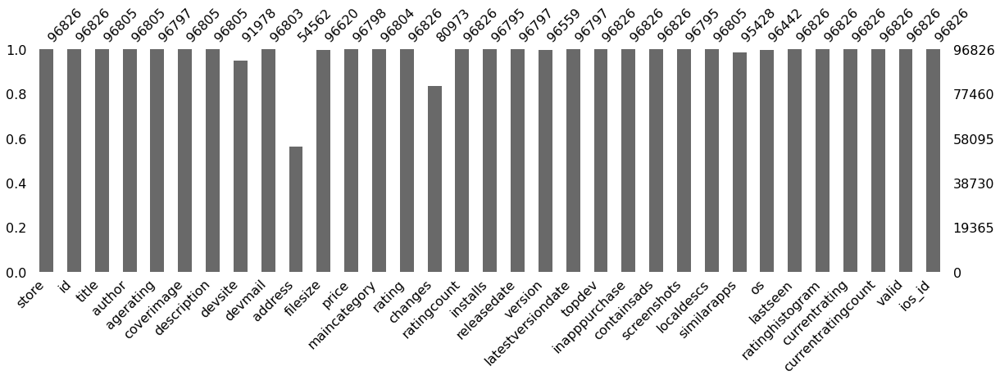

In [19]:
msno.bar(google_play_df, figsize=(20, 5))

<h3>Apple store missing data</h3>

<AxesSubplot:>

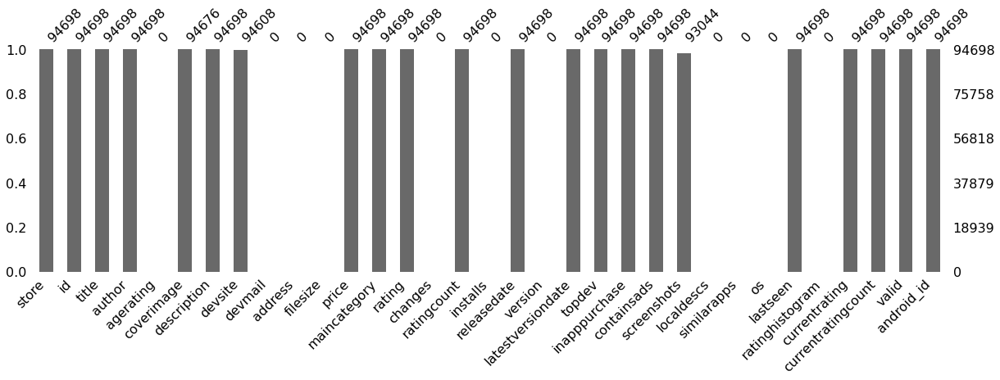

In [20]:
 msno.bar(app_store_df, figsize=(20, 5))

# Irelarevent featurs in apple

In [11]:
app_store_df['inapppurchase'].value_counts() # need to delete

False    94698
Name: inapppurchase, dtype: int64

In [24]:
app_store_df['lastseen'].value_counts() # need to delete,    January 24, 2021 ??

1.611447e+12    94075
1.610132e+12      623
Name: lastseen, dtype: int64

In [25]:
google_play_df['lastseen'].value_counts() # ??

1.611879e+12    21425
1.612225e+12    20521
1.612138e+12     5874
1.611965e+12     2733
1.612052e+12     2435
                ...  
1.557520e+12        1
1.557516e+12        1
1.557511e+12        1
1.557508e+12        1
1.513932e+12        1
Name: lastseen, Length: 18223, dtype: int64

In [26]:
app_store_df['valid'].value_counts()

True    94698
Name: valid, dtype: int64

In [27]:
google_play_df['valid'].value_counts()

True    96826
Name: valid, dtype: int64

In [ ]:
app_store_df['topdev'].value_counts()

In [ ]:
app_store_df['containsads'].value_counts()

# Ratings Histograms Numeric Features

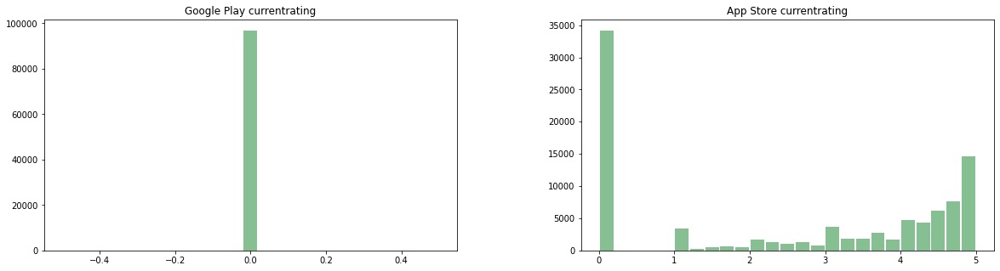

In [28]:
fig, axes = plt.subplots(1, 2, figsize=(20,5), squeeze=False)
google_play_df.hist(column='currentrating', bins=25, grid=False,ax=axes[0, 0],  color='#86bf91', zorder=2, rwidth=0.9)
app_store_df.hist(column='currentrating', bins=25, grid=False,ax=axes[0, 1],  color='#86bf91', zorder=2, rwidth=0.9)
axes[0,0].set_title("Google Play currentrating")
axes[0,1].set_title("App Store currentrating")
plt.show()

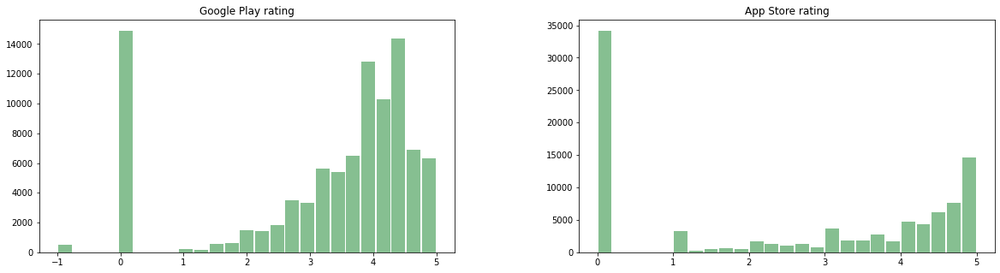

In [29]:
fig, axes = plt.subplots(1, 2, figsize=(20,5), squeeze=False)
google_play_df.hist(column='rating', bins=25, grid=False, ax=axes[0, 0], color='#86bf91', zorder=2, rwidth=0.9)
app_store_df.hist(column='rating', bins=25, grid=False, ax=axes[0, 1], color='#86bf91', zorder=2, rwidth=0.9)
axes[0,0].set_title("Google Play rating")
axes[0,1].set_title("App Store rating")
plt.show()

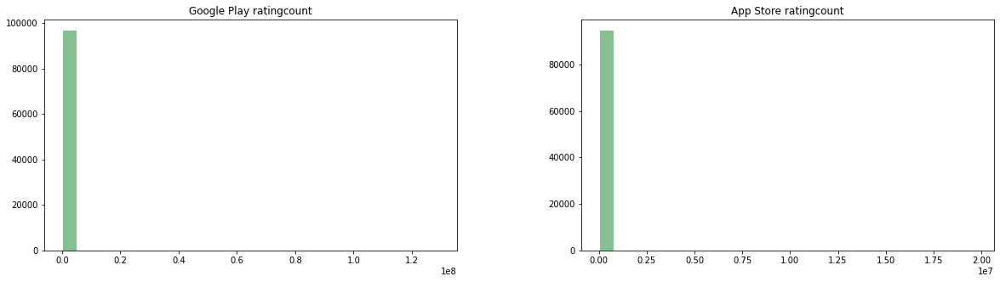

In [30]:
fig, axes = plt.subplots(1, 2, figsize=(20,5), squeeze=False)
google_play_df.hist(column='ratingcount', bins=25, grid=False,ax=axes[0, 0], figsize=(6,5), color='#86bf91', zorder=2, rwidth=0.9)
app_store_df.hist(column='ratingcount', bins=25, grid=False,ax=axes[0, 1], figsize=(6,5), color='#86bf91', zorder=2, rwidth=0.9)
axes[0,0].set_title("Google Play ratingcount")
axes[0,1].set_title("App Store ratingcount")
plt.show()

# Price histograms
<br>
<h3>"price": is a string with dollars, replace it to numeric:</h3>

In [31]:
google_play_df['price'].replace('Free', '$0', inplace = True)
google_play_df['price'] = google_play_df['price'].replace('[\$,]', '', regex=True).astype(float)

app_store_df['price'] = app_store_df['price'].replace(r"[a-zA-Z]", '', regex=True).astype(float)

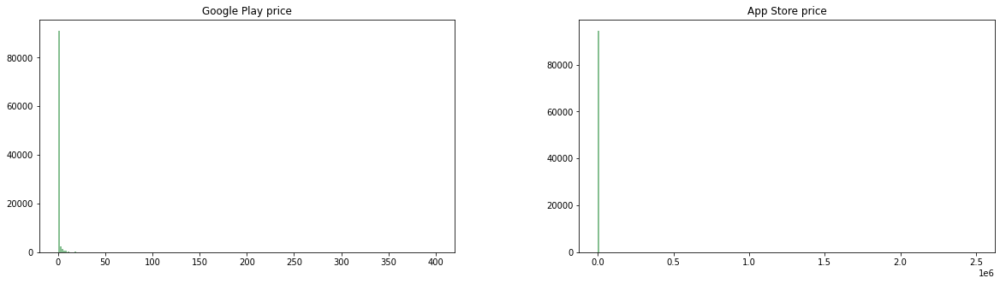

In [32]:
fig, axes = plt.subplots(1, 2, figsize=(20,5), squeeze=False)
google_play_df.hist(column='price', bins=200, grid=False,ax=axes[0, 0], figsize=(6,5), color='#86bf91', zorder=2, rwidth=0.9)
app_store_df.hist(column='price', bins=200, grid=False,ax=axes[0, 1], figsize=(6,5), color='#86bf91', zorder=2, rwidth=0.9)
axes[0,0].set_title("Google Play price")
axes[0,1].set_title("App Store price")
plt.show()

# Ratings Correlations

Text(0.5, 1.0, 'rating')

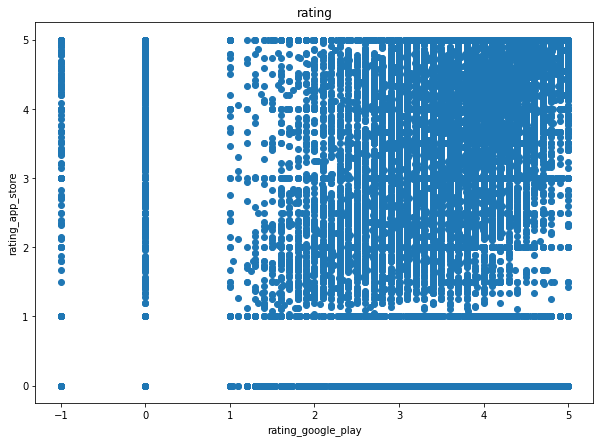

In [35]:
plt.figure(figsize=(10,7))
plt.scatter(matched_google_play.rating_google_play, matched_google_play.rating_app_store  , marker='o')
plt.xlabel("rating_google_play")
plt.ylabel("rating_app_store")
plt.title("rating")

Text(0.5, 1.0, 'ratingcount')

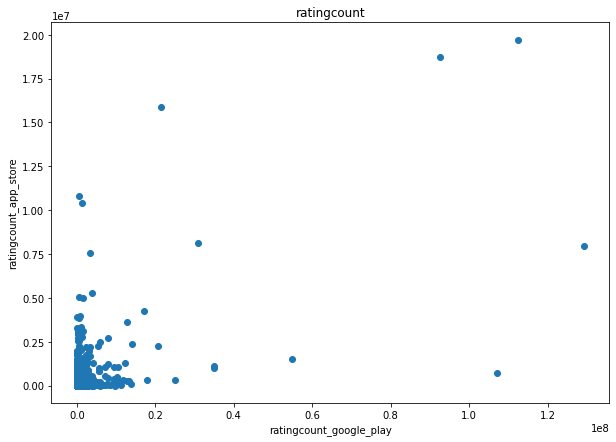

In [36]:
plt.figure(figsize=(10,7))
plt.scatter(matched_google_play.ratingcount_google_play, matched_google_play.ratingcount_app_store  , marker='o')
plt.xlabel("ratingcount_google_play")
plt.ylabel("ratingcount_app_store")
plt.title("ratingcount")

Text(0.5, 1.0, 'currentratingcount')

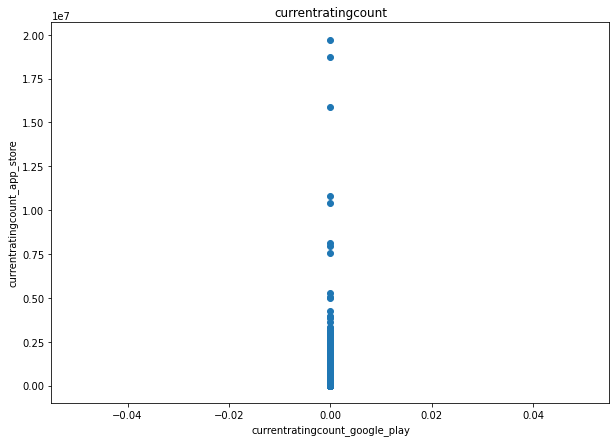

In [37]:
plt.figure(figsize=(10,7))
plt.scatter(matched_google_play.currentratingcount_google_play, matched_google_play.currentratingcount_app_store  , marker='o')
plt.xlabel("currentratingcount_google_play")
plt.ylabel("currentratingcount_app_store")
plt.title("currentratingcount")

# Main Category Matches

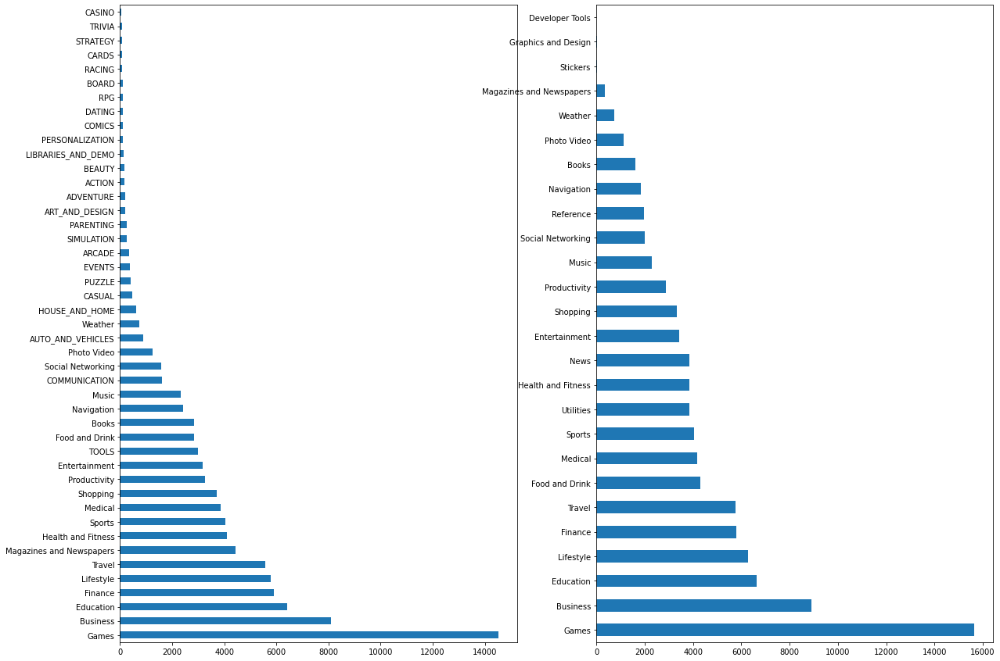

In [38]:
fig, axes = plt.subplots(1,2, figsize=(20,15), squeeze=False)
google_play_df['maincategory'].value_counts().plot(kind='barh', ax=axes[0, 0])
app_store_df['maincategory'].value_counts().plot(kind='barh', ax=axes[0, 1])
plt.show()

In [39]:
matched_google_play['count_maincategory_matches'] = np.where(matched_google_play['maincategory_google_play'] == matched_google_play['maincategory_app_store'], True, False)

In [40]:
matched_google_play[['maincategory_google_play', 'maincategory_app_store', 'count_maincategory_matches']]

,maincategory_google_play,maincategory_app_store,count_maincategory_matches
0,Food and Drink,Food and Drink,True
1,Social Networking,Social Networking,True
2,Lifestyle,Lifestyle,True
3,TOOLS,Utilities,False
4,COMMUNICATION,Utilities,False
...,...,...,...
62780,Education,Education,True
62781,Games,Education,False
62782,Lifestyle,Lifestyle,True
62783,Music,Music,True


In [41]:
matched_google_play.maincategory_google_play.groupby(matched_google_play['count_maincategory_matches']).count()

count_maincategory_matches
False    19646
True     43127
Name: maincategory_google_play, dtype: int64

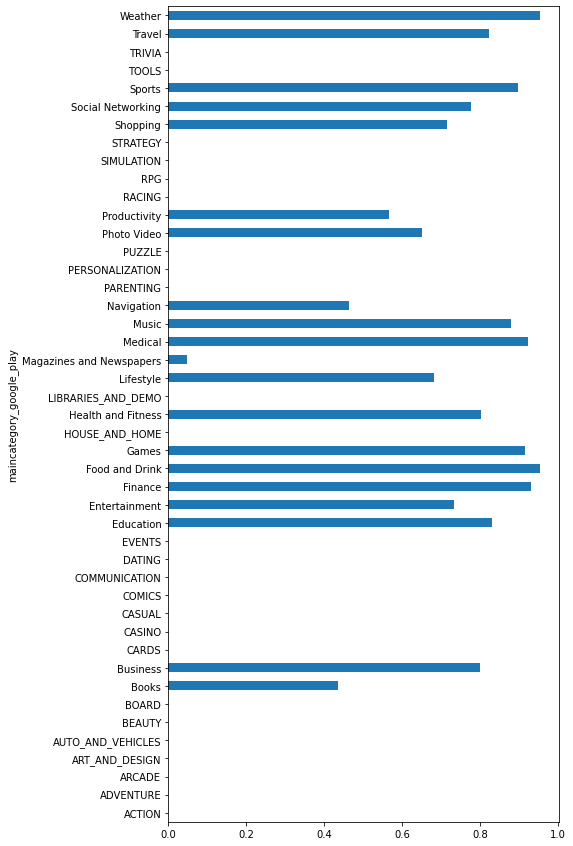

In [42]:
ratio_maincategory_matches =  matched_google_play.id_google_play.groupby(matched_google_play.loc[matched_google_play['count_maincategory_matches'] == True]['maincategory_google_play']).count()/matched_google_play.id_google_play.groupby(matched_google_play['maincategory_google_play']).count()
ratio_maincategory_matches.plot(kind='barh',figsize=(7,15))
plt.show()

# String Similarties

In [327]:
def get_string_differences(app_store_strings, google_play_strings):
    title_differences = []

    for i in range(len(app_store_strings)):
        android_string = google_play_strings[i]
        apple_string = app_store_strings[i]
        jaro = lev.ratio(android_string, apple_string)
        title_differences = np.append(title_differences, jaro)
    
    plt.hist(title_differences, bins = 50)
    plt.show()
    print(f'number of differences with 1 value: {title_differences[title_differences == 1.].size}')

    return title_differences

def get_missed(google, apple, differences):
    missed_google_play = google[np.where(differences < 1)]
    missed_apple = apple[np.where(differences < 1)]

    data = {'missed_google_play': missed_google_play, 'missed_apple': missed_apple}
    df = pd.DataFrame(data=data)
    print(f'missed size: {missed_apple.size}')

    return (missed_google_play, missed_apple, df)

<h2>Title</h2>

In [328]:
google_play_titles =  matched_google_play['title_google_play'].values.astype(str)
app_store_titles = matched_google_play['title_app_store'].values.astype(str)

In [329]:
app_store_titles.size

62785

<h3> Before Proccessing </h3>

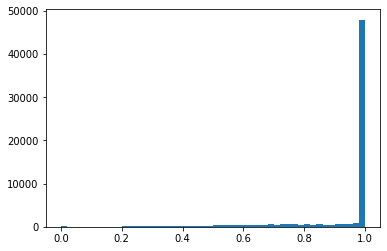

number of differences with 1 value: 47679


In [330]:
title_differences = get_string_differences(app_store_titles, google_play_titles)

In [331]:
missed_google_titles, missed_apple_titles, df = get_missed(google_play_titles, app_store_titles, title_differences)

df.head(50)

missed size: 15106


,missed_google_play,missed_apple
0,BingFeng Forum,冰楓論壇
1,OCBC Wing Hang Macau,澳門華僑永亨銀行
2,Mahjong Challenge,Mahjong Challenge Tile Matches
3,BB - Love Their Neighbors,Love Their Neighbors - BB
4,Godzilla Play Muscle Brother!,筋肉兄貴のゴジラごっこ！
5,PGA Merchandise Show 2019,PGA Merchandise Show
6,Dance Sound Design Bass,Bass Dance Music Sound Design
7,AUTOhebdo SPORT (Revista),AUTOhebdo SPORT (revista)
8,Afrobaskets,AfroBaskets
9,Fanddle,Fanddle 팬들


Before pre processing - 15106 out of 62785 (~25%) matched apps had similarty smaller than 1

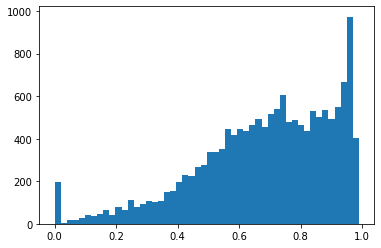

number of differences with 1 value: 0


In [332]:
missed_title_differences = get_string_differences(missed_apple_titles, missed_google_titles)

<h3> After Processing </h3>

In [333]:
'''
Steps:
1) lower 
2) strip
3) parition by : -  and space
'''
def preprocessing_titles(titles):
    # lower case the titles and seperate the title
    titles = [title.lower().strip().partition(':')[0].partition('-')[0].partition(' ')[0] for title in titles]
    
    return np.array(titles)

In [334]:
clean_google_titles = preprocessing_titles(missed_google_titles)
clean_apple_titles = preprocessingAz_titles(missed_apple_titles)

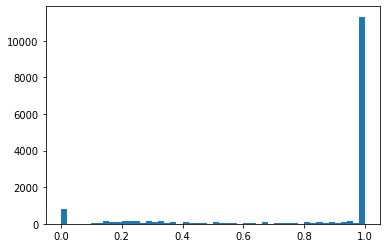

number of differences with 1 value: 11321


In [335]:
clean_title_differences = get_string_differences(clean_apple_titles, clean_google_titles)

In [336]:
missed_clean_google_titles, missed_clean_apple_titles, df = get_missed(clean_google_titles, clean_apple_titles, clean_title_differences)

df.head(50)

missed size: 3785


,missed_google_play,missed_apple
0,bingfeng,冰楓論壇
1,ocbc,澳門華僑永亨銀行
2,bb,love
3,godzilla,筋肉兄貴のゴジラごっこ！
4,dance,bass
5,ismartpalette,smartpallete
6,diet,5
7,flashacademy®,flashacademy
8,dies,筋肉兄貴の怒りの日！
9,entertainment,ds


preprocessing managed to reduce the labels with similarties smaller then 1 from 15K to ~3K <br>
farther improvement can include checking if the title is contained / starts with the other title

<h2>Author</h2>

In [337]:
google_play_author =  matched_google_play['author_google_play'].values.astype(str)
app_store_author = matched_google_play['author_app_store'].values.astype(str)

app_store_author.size

62785

<h2>Before preprocessing</h2>

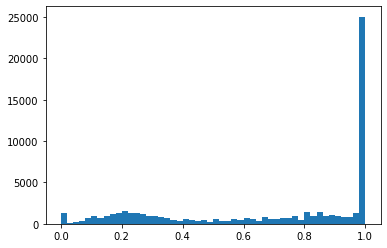

number of differences with 1 value: 24728


In [338]:
author_differences = get_string_differences(app_store_author, google_play_author)

In [339]:
missed_google_authors, missed_apple_authors, df = get_missed(google_play_author, app_store_author, author_differences)

df.head(50)

missed size: 38057


,missed_google_play,missed_apple
0,"Philz Coffee, Inc.",Philz Coffee
1,BingFeng,"BingFeng Co., Ltd."
2,AILES TOKYO Inc.,AILES TOKYO INC.
3,Charter/Spectrum,Charter Communications
4,American Tall LTD,American Tall
5,easyrecrue,EasyRecrue
6,AxiomJa,Damien Dunn
7,OCBC Wing Hang Bank Limited.,OCBC Wing Hang Bank Limited (Macau)
8,Sincetimes Inc.,Sincetimes Korea
9,Pulsar Engineering srl,LuForLu


Before pre processing - 38057 out of 62785 (~60%) matched apps had similarty smaller than 1

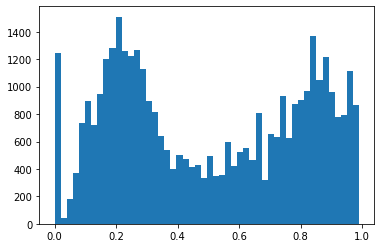

number of differences with 1 value: 0


In [340]:
author_differences = get_string_differences(missed_apple_authors, missed_google_authors)

<h2>After preprocessing</h2>

In [341]:
'''
Steps:
1) lower 
2) strip
3) Remove company endings using basename
'''
def preprocessing_author(authors):
    terms = prepare_terms()
    # Running twice in order to remove multiple endings, i.e Co., Ltd.
    authors = [basename(author.lower().strip(), terms, prefix=True, middle=True, suffix=True) for author in authors]
    authors = [basename(author, terms, prefix=True, middle=True, suffix=True).partition(' ')[0] for author in authors]
    
    return np.array(authors)

In [342]:
clean_google_authors = preprocessing_author(missed_google_authors)
clean_apple_authors = preprocessing_author(missed_apple_authors)

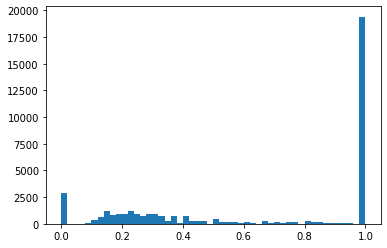

number of differences with 1 value: 19408


In [343]:
clean_author_differences = get_string_differences(clean_apple_authors, clean_google_authors)

In [344]:
missed_clean_google_authors, missed_clean_apple_authors, df = get_missed(clean_google_authors, clean_apple_authors, clean_author_differences)

df.head(50)

missed size: 18649


,missed_google_play,missed_apple
0,charter/spectrum,charter
1,axiomja,damien
2,pulsar,luforlu
3,vibolrith,rada
4,okpar,nyein
5,マイスターソフト,shoji
6,people,pocketpixi.com
7,sherpa,reed
8,head,carlos
9,askvideo.com,ask


preprocessing managed to reduce the authors with similarties smaller then 1 from 38K to ~19K <br>
farther improvement seems hard since no clear formating can be done

# devsite similarties

In [345]:
google_play_devsite =  matched_google_play['devsite_google_play'].values.astype(str)
app_store_devsite = matched_google_play['devsite_app_store'].values.astype(str)

In [361]:
app_store_devsite.size

62785

<h3>Before preprocessing</h3>

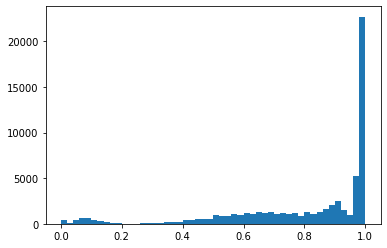

number of differences with 1 value: 19490


In [346]:
devsite_differences = get_string_differences(app_store_devsite, google_play_devsite)

In [347]:
missed_google_devsite, missed_apple_devsite, df = get_missed(google_play_devsite, app_store_devsite, devsite_differences)

df.head(50)

missed size: 43295


,missed_google_play,missed_apple
0,https://www.philzcoffee.com/,https://www.philzcoffee.com/app
1,https://bingfeng.tw/,https://bingfeng.tw/forum.php
2,http://www.amsinc.co.jp/,https://envym-store.jp/ap/contact
3,http://www.spectrum.com,http://brighthouse.com/my-services/my-services...
4,nan,http://www.depolitieapp.be/
5,http://www.americantall.com,http://americantall.com/
6,nan,http://phorest.com
7,http://www.easyrecrue.com,https://www.easyrecrue.com/en/
8,https://jamaicanstyledominoes.com,https://www.facebook.com/JamaicanStyleDominoes...
9,http://www.gadventures.com/,http://www.gadventures.com/mobile


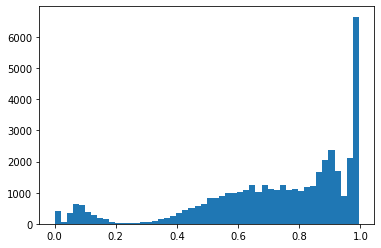

number of differences with 1 value: 0


In [355]:
missed_devsite = get_string_differences(missed_apple_devsite, missed_google_devsite)

Before pre processing - 43295 out of 62785 (~66%) matched apps had similarty smaller than 1

<h3>After preprocessong</h3>

In [362]:
'''
Steps:
1) lower 
2) strip
3) retrive domain using tldextract
'''
def preprocessing_devsite(devsites):
    devsites = [tldextract.extract(devsite.lower().strip()).domain for devsite in devsites]
    
    return np.array(devsites)

In [363]:
clean_google_devsite = preprocessing_devsite(missed_google_devsite)
clean_apple_devsite = preprocessing_devsite(missed_apple_devsite)

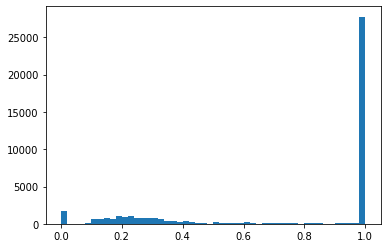

number of differences with 1 value: 27768


In [364]:
clean_devsite_differences = get_string_differences(clean_apple_devsite, clean_google_devsite)

In [365]:
missed_clean_google_devsite, missed_clean_apple_devsite, df = get_missed(clean_google_devsite, clean_apple_devsite, clean_devsite_differences)

df.head(50)

missed size: 15527


,missed_google_play,missed_apple
0,amsinc,envym-store
1,spectrum,brighthouse
2,nan,depolitieapp
3,nan,phorest
4,jamaicanstyledominoes,facebook
5,sherpa-solutions,pgashow
6,louisvillegeek,headcoachapp
7,askvideo,ask
8,make-it-app,makeitapp
9,app-ads-txt,shinetechnolab


preprocessing managed to reduce the authors with similarties smaller then 1 from 44K to ~15K
farther improvement seems hard since no clear formating can be done

# Description similarties

In [367]:
google_play_description =  matched_google_play['description_google_play'].values.astype(str)
app_store_description = matched_google_play['description_app_store'].values.astype(str)

In [376]:
google_play_description[0]

"Welcome to the Philz Coffee app! It's never been easier to order your Cup of Love for pick-up, customize your coffee to your personal taste, and reorder your favorites. Download the app today and experience Philz at your fingertips.\n\nApp Features:\n- Order your favorite coffee or tea ahead of time for convenient pick-up\n- Customize your drink to your personal taste\n- Get order updates when your drink is being made and when it's ready for pick-up\n- See which barista is crafting your cup to be just right\n- Browse through your favorites menu to make a selection in a snap\n- Easily reorder your go-to drink\n- Find your nearest Philz when you're on the go"

In [416]:
def process_tfidf_similarity(apple_description, google_description):
    vectorizer = TfidfVectorizer()
    embeddings = vectorizer.fit_transform([apple_description, google_description])
    cosine_similarities = cosine_similarity(embeddings[0:1], embeddings[1:]).flatten()

    return cosine_similarities 

def get_description_differences(apple_descriptions, google_descriptions): 
    differences = []

    for i in range(len(apple_descriptions)):
        apple_description = apple_descriptions[i]
        google_description = google_descriptions[i]
        cosin = process_tfidf_similarity(apple_description,google_description)
        differences.append(round(cosin[0], 2))
    plt.hist(differences, bins = 50)
    plt.show()
    # print(f'number of differences with 1 value: {title_differences[title_differences == 1.].size}')

    return np.array(differences)

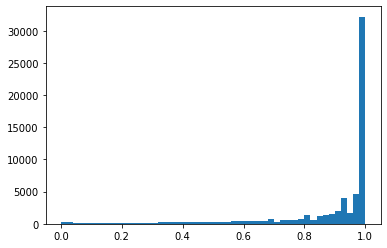

CPU times: user 2min 7s, sys: 1.67 s, total: 2min 8s
Wall time: 2min 9s


In [417]:
%%time
diff = get_description_differences(app_store_description, google_play_description)

In [420]:
diff[diff == 1.].size

24223

In [418]:
missed_google_descriptions, missed_apple_descriptions, df = get_missed(google_play_description, app_store_description, diff)

df.head(5)

missed size: 38562


,missed_google_play,missed_apple
0,De politie app is een gebruiksvriendelijke app...,De politie app is een gebruiksvriendelijke app...
1,"• Shop instantly. No googling, no lag, no nons...","Finally, tall styles designed exclusively for ..."
2,The G Adventures App helps you conveniently pr...,Meet your new travel buddy\nThe ultimate digit...
3,OCBC Wing Hang Bank Limited provides the most ...,OCBC Wing Hang Bank Limited provides the most ...
4,**故事發生在1939年9月3日晚，赫布里底群島以西，Z字反潛機動航行的客輪雅典娜號被德國潛...,**故事發生在1939年9月3日晚，赫布里底群島以西，Z字反潛機動航行的客輪雅典娜號被德國潛...


Before pre processing - 38562 out of 62785 (~55%) matched apps had similarty smaller than 1

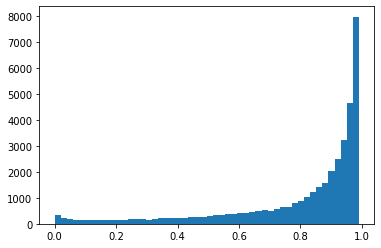

CPU times: user 1min 22s, sys: 2.52 s, total: 1min 24s
Wall time: 1min 26s


In [421]:
%%time
diff = get_description_differences(missed_apple_descriptions, missed_google_descriptions)

<h3>After preprocessing</h3>

In [452]:
'''
Steps:
1) remove digits 
2) unicode
3) lower 
4) remove symbols - [!”#$%&’()*+,-./:;<=>?@[\]^_`{|}~]
5) strip
'''

def preprocess_descriptions(descriptions):
    descriptions = [unidecode.unidecode(re.sub(r'\d+', '', description)).lower().translate(str.maketrans("","", string.punctuation)).strip() for description in descriptions]
    
    return np.array(descriptions)

In [453]:
%%time

clean_google_descriptions = preprocess_descriptions(missed_google_descriptions)
clean_apple_descriptions = preprocess_descriptions(missed_apple_descriptions)

CPU times: user 29.3 s, sys: 2.48 s, total: 31.8 s
Wall time: 32.9 s


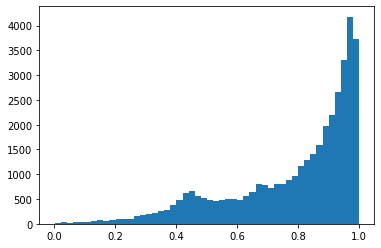

number of differences with 1 value: 105


In [454]:
clean_description_differences = get_string_differences(clean_apple_descriptions, clean_google_descriptions)

# Comparing release date dates

In [71]:
def parse_date(date):
    if not isinstance(date, str):
        # always nan values
        return

    return dateparser.parse(date)

In [72]:
releasedate_google_play = matched_google_play['releasedate_google_play'].apply(parse_date)
releasedate_app_store = matched_google_play['releasedate_app_store'].apply(parse_date)

In [73]:
releasedate_google_play_values = releasedate_google_play.values.astype('datetime64[D]')
releasedate_app_store_values = releasedate_app_store.values.astype('datetime64[D]')

In [74]:
nat_android_index = np.where(np.isnat(releasedate_google_play_values))
nat_apple_index = np.where(np.isnat(releasedate_app_store_values))

In [75]:
# Remove nat values from both apple and android dates

android_without_nat = np.delete(releasedate_google_play_values, nat_android_index)
android_without_nat = np.delete(android_without_nat, nat_apple_index)

apple_without_nat = np.delete(releasedate_app_store_values, nat_apple_index)
apple_without_nat = np.delete(apple_without_nat, nat_android_index)

In [76]:
android_without_nat

array(['2018-05-05', '2015-10-10', '2015-01-01', ..., '2016-10-10',
       '2018-11-11', '2016-02-02'], dtype='datetime64[D]')

In [77]:
differences = np.absolute(android_without_nat - apple_without_nat).astype(int)

In [78]:
np.median(differences)

29.0

In [79]:
np.mean(differences)

241.0402756288581

In [80]:
# q1 = differences[differences <= 10]
# q2 = differences[np.logical_and(differences > 0.10, differences <= 20)]
# q3 = differences[np.logical_and(differences >20, differences <= 30)]
# q4 = differences[np.logical_and(differences > 30, differences <= 40)]
# q5 = differences[np.logical_and(differences > 40, differences <= 50)]
# q6 = differences[np.logical_and(differences > 50, differences <= 60)]
# q7 = differences[np.logical_and(differences > 60, differences <= 70)]
# q8 = differences[np.logical_and(differences > 70, differences <= 80)]
# q9 = differences[np.logical_and(differences > 80, differences <= 90)]
# q10 = differences[np.logical_and(differences > 90, differences <= 100)]
# q_end = differences[differences > 100]